<h1> Important imports </h1>

In [ ]:
! pip install tf_explain
! pip install keras_preprocessing

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 1.9 MB/s eta 0:00:00


In [ ]:
! mkdir ~/.kaggle

In [ ]:
! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle competitions download -c state-farm-distracted-driver-detection

100% 4.00G/4.00G [02:24<00:00, 37.7MB/s]
100% 4.00G/4.00G [02:24<00:00, 29.7MB/s]


In [ ]:
! unzip state-farm-distracted-driver-detection

Streaming output truncated to the last 5000 lines.
  inflating: imgs/train/c7/img_56636.jpg  
  inflating: imgs/train/c7/img_56661.jpg  
  inflating: imgs/train/c7/img_56699.jpg  
  inflating: imgs/train/c7/img_56717.jpg  
  inflating: imgs/train/c7/img_56724.jpg  
  inflating: imgs/train/c7/img_56768.jpg  
  inflating: imgs/train/c7/img_56779.jpg  
  inflating: imgs/train/c7/img_56849.jpg  
  inflating: imgs/train/c7/img_56899.jpg  
  inflating: imgs/train/c7/img_56938.jpg  
  inflating: imgs/train/c7/img_5706.jpg  
  inflating: imgs/train/c7/img_57076.jpg  
  inflating: imgs/train/c7/img_57122.jpg  
  inflating: imgs/train/c7/img_57137.jpg  
  inflating: imgs/train/c7/img_5715.jpg  
  inflating: imgs/train/c7/img_57278.jpg  
  inflating: imgs/train/c7/img_57321.jpg  
  inflating: imgs/train/c7/img_57345.jpg  
  inflating: imgs/train/c7/img_57355.jpg  
  inflating: imgs/train/c7/img_5741.jpg  
  inflating: imgs/train/c7/img_57433.jpg  
  inflating: imgs/train/c7/img_5753.jpg  
  infla

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import cv2 #opencv library
import glob
import matplotlib.pyplot as plt  #plotting library
import matplotlib.image as mpimg
from sklearn.model_selection import train_test_split
import tensorflow as tf
import random
from skimage import io
from keras.callbacks import EarlyStopping
from PIL import Image
from tqdm import tqdm
import h5py
import seaborn as sns
import os
import random as rnd
import secrets
import plotly.express as px
from tf_explain.core.activations import ExtractActivations
from tf_explain.core.grad_cam import GradCAM
from tensorflow.keras.layers import Input, Conv2D,GlobalAveragePooling2D , MaxPooling2D, AveragePooling2D, Concatenate, Flatten, Dense
from tensorflow.keras.applications import ResNet50
from keras import layers
from keras import models
from keras import optimizers
from keras.models import Sequential, Model
from tensorflow.keras.applications.resnet50 import preprocess_input
from keras.preprocessing.image import ImageDataGenerator
from keras_preprocessing.image import img_to_array, load_img
from keras.layers import Convolution2D,Conv2D, MaxPooling2D, Flatten, Dense, Dropout,BatchNormalization
print(os.listdir("/content/imgs"))

['train', 'test']


<h1> Setting directory paths </h1>

In [ ]:
df_train_full = pd.read_csv('/content/driver_imgs_list.csv')
df_train_full['path']= '/content/imgs/train/' + df_train_full['classname']+ '/' +df_train_full['img']
df_test = '/content/imgs/test'
train_dir='/content/imgs/train/'

In [ ]:
classes = {   'c0' : "safe_driving",
                      'c1' : "texting-right",
                      'c2' : "talking_on_the_phone-right",
                      'c3' : "texting-left",
                      'c4' : "talking_on_the_phone-left",
                      'c5' : "operating_the_radio",
                      'c6' : "drinking",
                      'c7' : "reaching_behind",
                      'c8' : "hair-and-makeup",
                      'c9' : "talking_to_passenger"}
classes

{'c0': 'safe_driving',
 'c1': 'texting-right',
 'c2': 'talking_on_the_phone-right',
 'c3': 'texting-left',
 'c4': 'talking_on_the_phone-left',
 'c5': 'operating_the_radio',
 'c6': 'drinking',
 'c7': 'reaching_behind',
 'c8': 'hair-and-makeup',
 'c9': 'talking_to_passenger'}

In [ ]:
df_train_full.head()

,subject,classname,img,path
0,p002,c0,img_44733.jpg,/content/imgs/train/c0/img_44733.jpg
1,p002,c0,img_72999.jpg,/content/imgs/train/c0/img_72999.jpg
2,p002,c0,img_25094.jpg,/content/imgs/train/c0/img_25094.jpg
3,p002,c0,img_69092.jpg,/content/imgs/train/c0/img_69092.jpg
4,p002,c0,img_92629.jpg,/content/imgs/train/c0/img_92629.jpg


In [ ]:
num_samples_to_use = int(0.25 * len(df_train_full))
subset_indices = random.sample(range(len(df_train_full)), num_samples_to_use)
df_train = df_train_full.iloc[subset_indices]

# Print the number of samples in the 25% subset
print("Number of samples in 25% subset:", len(df_train))

Number of samples in 25% subset: 5606


In [ ]:
print("Number of image files for in training dataset: ",len(df_train))
print("Number of classes: ",len(df_train['classname'].value_counts()))

Number of image files for in training dataset:  5606
Number of classes:  10


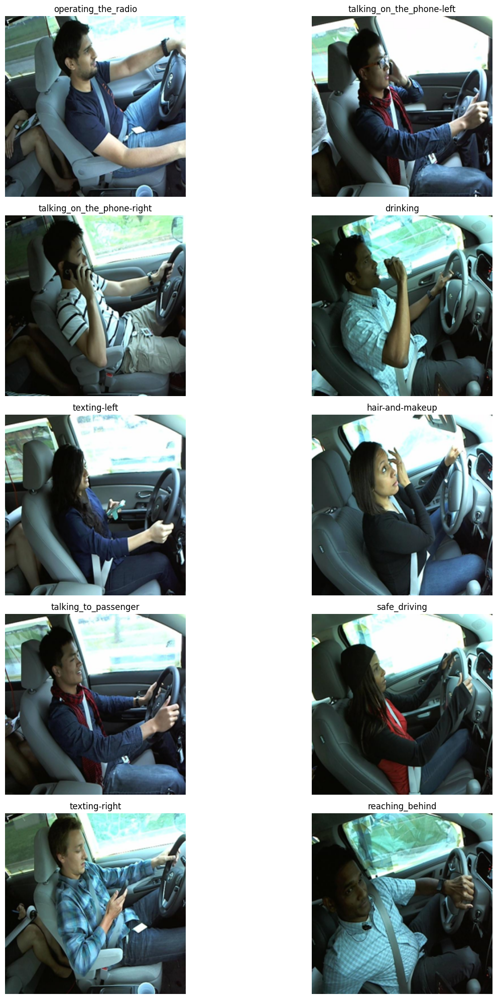

In [ ]:
plt.figure(figsize = (15,20))
for idx,i in enumerate(df_train.classname.unique()):
    plt.subplot(5,2,idx+1)
    df = df_train[df_train['classname'] ==i].reset_index(drop = True)
    image_path = df.loc[rnd.randint(0, len(df))-1,'path']
    img = Image.open(image_path)
    img = img.resize((224,224))
    plt.imshow(img)
    plt.axis('off')
    plt.title(classes[i])
plt.tight_layout()
plt.show()

In [ ]:
# Create the count plot
fig = px.histogram(df_train, x='classname', color_discrete_sequence=['blue'])  # Change the color here

# Set the layout
fig.update_layout(
    title='Driver Class Distribution',
    title_font=dict(family='Arial', size=24),  # Change the font family and size for the title
    xaxis_title='Driver classes',
    xaxis=dict(title_font=dict(family='Arial', size=18)),  # Change the font family and size for x-axis label
    yaxis_title='Count',
    yaxis=dict(title_font=dict(family='Arial', size=14)),  # Change the font family and size for y-axis label
    autosize=False,
    width=800,
    height=600,
    margin=dict(l=50, r=50, t=100, b=50),
)



# Show the plot
fig.show()

In [ ]:
widths, heights = [], []

for path in tqdm(df_train["path"]):
    width, height = Image.open(path).size
    widths.append(width)
    heights.append(height)

df_train["width"] = widths
df_train["height"] = heights
df_train["dimension"] = df_train["width"] * df_train["height"]

100%|██████████| 5606/5606 [00:00<00:00, 13957.79it/s]
<ipython-input-15-45a28a193c6a>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-15-45a28a193c6a>:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-15-45a28a193c6a>:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#r

In [ ]:
df_train

,subject,classname,img,path,width,height,dimension
9716,p035,c5,img_89638.jpg,/content/imgs/train/c5/img_89638.jpg,640,480,307200
7430,p024,c4,img_37385.jpg,/content/imgs/train/c4/img_37385.jpg,640,480,307200
1252,p012,c5,img_91231.jpg,/content/imgs/train/c5/img_91231.jpg,640,480,307200
15626,p051,c2,img_71165.jpg,/content/imgs/train/c2/img_71165.jpg,640,480,307200
513,p002,c6,img_74174.jpg,/content/imgs/train/c6/img_74174.jpg,640,480,307200
...,...,...,...,...,...,...,...
16329,p052,c1,img_21492.jpg,/content/imgs/train/c1/img_21492.jpg,640,480,307200
7407,p024,c4,img_73145.jpg,/content/imgs/train/c4/img_73145.jpg,640,480,307200
3575,p016,c2,img_73240.jpg,/content/imgs/train/c2/img_73240.jpg,640,480,307200
16859,p052,c8,img_83156.jpg,/content/imgs/train/c8/img_83156.jpg,640,480,307200


<h1> Create training / test data </h1>

**Augmentation**


In [ ]:
def increase_brightness(img, value):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)

    lim = 255 - value
    v[v > lim] = 255
    v[v <= lim] += value

    final_hsv = cv2.merge((h, s, v))
    img = cv2.cvtColor(final_hsv, cv2.COLOR_HSV2BGR)
    return img

def change_contrast(img, level):
    img = Image.fromarray(img.astype('uint8'))
    factor = (259 * (level + 255)) / (255 * (259 - level))
    def contrast(c):
        return 128 + factor * (c - 128)
    return np.array(img.point(contrast))

def preprocessing(img):
    img_arr = np.array(img)

    x = random.randint(0, 1)

    if x == 0:
        img_arr = increase_brightness(img_arr, secrets.randbelow(26))
        img_arr = change_contrast(img_arr, secrets.randbelow(51))
    else:
        img_arr = change_contrast(img_arr, secrets.randbelow(51))
        img_arr = increase_brightness(img_arr, secrets.randbelow(26))

    return img_arr


datagen = ImageDataGenerator(
        rotation_range = 5,
        width_shift_range = 0.03,
        height_shift_range = 0.03,
        shear_range = 0.03,
        zoom_range = 0.03,
        horizontal_flip = False,
        fill_mode = "nearest",
        validation_split = 0.2,
        preprocessing_function = preprocessing)

In [ ]:
X, y = df_train[['path', 'classname']], df_train['classname']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [ ]:
X_test

,path,classname
16728,/content/imgs/train/c6/img_96294.jpg,c6
6423,/content/imgs/train/c6/img_10431.jpg,c6
8878,/content/imgs/train/c6/img_29126.jpg,c6
13020,/content/imgs/train/c3/img_15114.jpg,c3
3810,/content/imgs/train/c4/img_4006.jpg,c4
...,...,...
10027,/content/imgs/train/c8/img_58392.jpg,c8
19470,/content/imgs/train/c0/img_20994.jpg,c0
4255,/content/imgs/train/c8/img_50462.jpg,c8
18396,/content/imgs/train/c7/img_5356.jpg,c7


In [ ]:
dict_class = {'c0':0, 'c1':1, 'c2': 2, 'c3': 3, 'c4': 4, 'c5':5, 'c6': 6, 'c7':7, 'c8':8, 'c9':9}

In [ ]:
def gradcam_visualise(data, model, class_index):
    explainer = GradCAM()
    output = explainer.explain(data, model, class_index=class_index)
    return output

def activation_visualise(image, model, layers):
    explainer = ExtractActivations()
    output = explainer.explain([image], model, layers_name=layers)
    return output

In [ ]:
def plot_data_four(class_name, outputs):
    fig = plt.figure(figsize=(16, 16))
    plt.suptitle(classes[class_name])
    plt.subplot(2,2,1)
    plt.imshow(outputs[0])
    plt.subplot(2,2,2)
    plt.imshow(outputs[1])
    plt.subplot(2,2,3)
    plt.imshow(outputs[2])
    plt.subplot(2,2,4)
    plt.imshow(outputs[3])
    plt.show()

In [ ]:
def grad_cam(model, df_exp, class_name, class_index, image_size):
    output_data = []
    classes_df = df_exp[df_exp['classname'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        image = cv2.resize(image, image_size)
        data = ([image], None)
        output = gradcam_visualise(data, model, class_index)
        output_data.append(output)
    plot_data_four(class_name, output_data)

In [ ]:
def activations_model(model, df_exp, class_name, layers, image_size):
    output_data = []
    classes_df = df_exp[df_exp['classname'] ==  class_name].reset_index(drop = True)
    for idx,i in enumerate(np.random.choice(classes_df['path'],4)):
        image = cv2.imread(i)
        image = cv2.resize(image, image_size)
        image = tf.expand_dims(image, axis=0)
        output = activation_visualise([image], model, layers)
        output_data.append(output)
    plot_data_four(class_name, output_data)

In [ ]:
#for class_name in X_test['classname'].unique():
   # grad_cam(model, X_test, class_name, dict_class[class_name], (240,240))

In [ ]:
#test_loss, test_accuracy = model.evaluate(validationGenerator_cnn, verbose=1)

# Print the test accuracy
#print("Test Accuracy:", test_accuracy)

In [ ]:
y_count=len(df_train['classname'].unique())
y_count

10

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetB4
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model

# Parameters
batch_size = 32
image_size = (224, 224)  # Input size expected by EfficientNetB0
num_classes = 10  # Number of classes in your dataset

# Load the EfficientNetB4 model with pre-trained weights from TensorFlow Hub
base_model = EfficientNetB4(include_top=False, weights='imagenet', input_shape=(*image_size, 3))

# Add custom classification head
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
predictions = Dense(num_classes, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Data augmentation using ImageDataGenerator
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    validation_split=0.2  # Split the data into training and validation sets
)

train_generator = datagen.flow_from_dataframe(
        X_train,  # This is the source directory for training images
        x_col='path',
        y_col='classname',
        target_size=(224, 224),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=False,

)

validation_generator = datagen.flow_from_dataframe(
        X_test,  # This is the source directory for test images
        x_col='path',
        y_col='classname',
        target_size=(224, 224),  # All images will be resized to 150x150
        batch_size=32,
        class_mode="categorical",
        shuffle=False,
)


# Train the model
history_eb4= model.fit(train_generator, validation_data=validation_generator, epochs=3)


Found 3924 validated image filenames belonging to 10 classes.
Found 1682 validated image filenames belonging to 10 classes.
Epoch 1/3
123/123 [==============================] - 223s 1s/step - loss: 0.5999 - accuracy: 0.8096 - val_loss: 0.3328 - val_accuracy: 0.9132
Epoch 2/3
123/123 [==============================] - 129s 1s/step - loss: 0.1835 - accuracy: 0.9455 - val_loss: 0.3359 - val_accuracy: 0.9061
Epoch 3/3
123/123 [==============================] - 125s 1s/step - loss: 0.1505 - accuracy: 0.9592 - val_loss: 0.2944 - val_accuracy: 0.9275


In [ ]:
test_loss, test_accuracy = model.evaluate(train_generator, verbose=1)

# Print the test accuracy
print("Test Accuracy:", test_accuracy)

 23/123 [====>.........................] - ETA: 56s - loss: 0.2051 - accuracy: 0.9416

KeyboardInterrupt: ignored

In [ ]:
test_loss, test_accuracy = model.evaluate(validation_generator, verbose=1)

# Print the test accuracy
print("Test Accuracy:", test_accuracy)

53/53 [==============================] - 31s 579ms/step - loss: 0.2944 - accuracy: 0.9203
Test Accuracy: 0.9203329086303711


In [ ]:
# Get the class labels from the generator
train_generator

In [ ]:
preds_val = model.predict(validation_generator)
preds_val

53/53 [==============================] - 32s 546ms/step


array([[5.3618651e-06, 4.3635869e-06, 2.4897507e-05, ..., 4.3270022e-05,
        4.7914691e-05, 1.2027235e-06],
       [1.1514371e-03, 1.6656106e-04, 5.9391103e-05, ..., 1.1107471e-04,
        4.2825466e-04, 1.6186626e-05],
       [1.7541995e-05, 6.7836795e-06, 1.0791273e-05, ..., 1.4300682e-05,
        4.6504338e-05, 8.8478254e-07],
       ...,
       [3.3171489e-04, 3.7427545e-02, 4.3423852e-04, ..., 3.7235045e-04,
        8.3985209e-01, 1.9802870e-03],
       [3.3596457e-06, 1.6540920e-05, 3.2652566e-05, ..., 9.9892563e-01,
        5.5950356e-04, 1.6382948e-04],
       [2.5570157e-04, 1.2462315e-04, 4.2689394e-04, ..., 2.9433793e-03,
        9.6731621e-01, 2.6618289e-02]], dtype=float32)

In [ ]:
predicted_labels = np.argmax(preds_val, axis=1)
predicted_labels

array([6, 6, 6, ..., 8, 7, 8])

In [ ]:
true_labels = validation_generator.classes
true_labels

[6,
 6,
 6,
 3,
 4,
 1,
 4,
 4,
 9,
 3,
 5,
 9,
 3,
 5,
 4,
 0,
 6,
 2,
 8,
 5,
 3,
 3,
 2,
 8,
 9,
 9,
 0,
 6,
 8,
 5,
 6,
 6,
 4,
 4,
 2,
 4,
 1,
 8,
 2,
 4,
 6,
 0,
 3,
 8,
 3,
 8,
 9,
 6,
 4,
 6,
 3,
 0,
 8,
 2,
 0,
 3,
 2,
 7,
 8,
 7,
 5,
 1,
 3,
 9,
 7,
 5,
 2,
 5,
 4,
 6,
 9,
 8,
 6,
 0,
 9,
 7,
 0,
 4,
 2,
 4,
 5,
 3,
 6,
 1,
 8,
 2,
 0,
 4,
 6,
 2,
 1,
 9,
 3,
 9,
 5,
 0,
 8,
 6,
 6,
 6,
 2,
 3,
 7,
 7,
 2,
 7,
 5,
 2,
 2,
 0,
 7,
 7,
 6,
 8,
 6,
 6,
 4,
 8,
 5,
 2,
 5,
 8,
 0,
 8,
 0,
 8,
 9,
 7,
 7,
 0,
 3,
 1,
 5,
 1,
 4,
 6,
 6,
 8,
 3,
 1,
 1,
 7,
 6,
 9,
 0,
 5,
 3,
 7,
 8,
 5,
 2,
 1,
 4,
 9,
 3,
 6,
 3,
 6,
 6,
 0,
 7,
 3,
 3,
 2,
 0,
 3,
 8,
 6,
 7,
 4,
 4,
 3,
 2,
 9,
 7,
 4,
 5,
 0,
 5,
 7,
 5,
 7,
 7,
 5,
 4,
 4,
 6,
 1,
 5,
 9,
 6,
 1,
 3,
 2,
 3,
 0,
 6,
 3,
 6,
 2,
 2,
 9,
 4,
 2,
 6,
 3,
 8,
 9,
 1,
 4,
 9,
 7,
 9,
 5,
 1,
 2,
 4,
 6,
 2,
 5,
 3,
 8,
 2,
 1,
 3,
 5,
 8,
 9,
 5,
 1,
 2,
 1,
 6,
 6,
 3,
 6,
 3,
 9,
 4,
 0,
 8,
 4,
 0,
 4,
 5,
 1,
 1,
 3,
 5,
 4,


In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
print(confusion_matrix(true_labels, predicted_labels))
print(classification_report(true_labels, predicted_labels ))

[[183   0   0   0   0   0   1   0   0   4]
 [  1 172   0   0   0   0   0   0   0   0]
 [  0   0 147   0   0   0   0   0   5   0]
 [  2  41   0 121   2  10   0   0   1   3]
 [  0   2   0   0 168   0   0   0   0   0]
 [  2   0   0   0   0 185   0   0   0   1]
 [  0   2   0   0   0   0 177   0   0   1]
 [  0   1   0   0   0   0   0 149   0   1]
 [  0   0   1   0   1   0  11   2 126   5]
 [ 13   0   0   0   0   2   0   0   6 133]]
              precision    recall  f1-score   support

           0       0.91      0.97      0.94       188
           1       0.79      0.99      0.88       173
           2       0.99      0.97      0.98       152
           3       1.00      0.67      0.80       180
           4       0.98      0.99      0.99       170
           5       0.94      0.98      0.96       188
           6       0.94      0.98      0.96       180
           7       0.99      0.99      0.99       151
           8       0.91      0.86      0.89       146
           9       0.90     

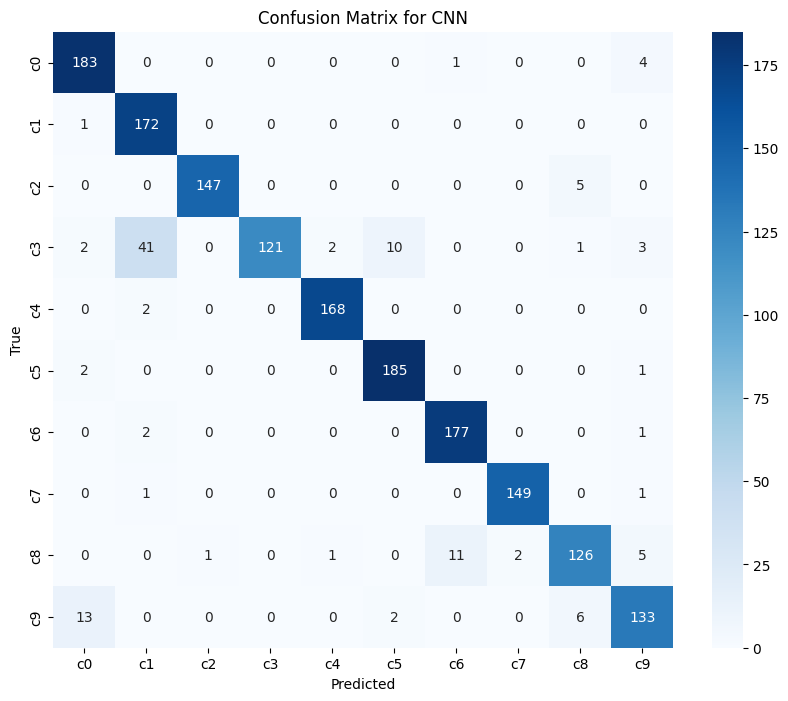

In [ ]:
# Create a heatmap of the confusion matrix
class_names = list(validation_generator.class_indices.keys())
plt.figure(figsize=(10, 8))
sns.heatmap(confusion_matrix(true_labels, predicted_labels), annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix for CNN')
plt.show()

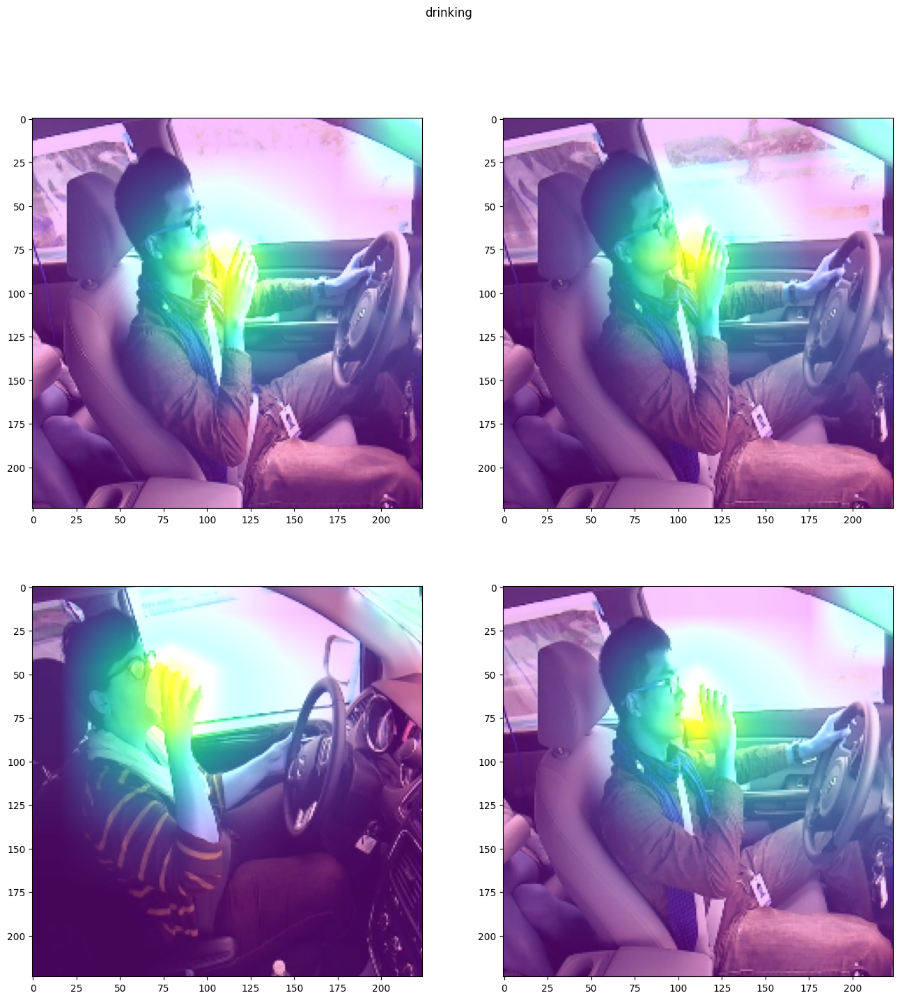

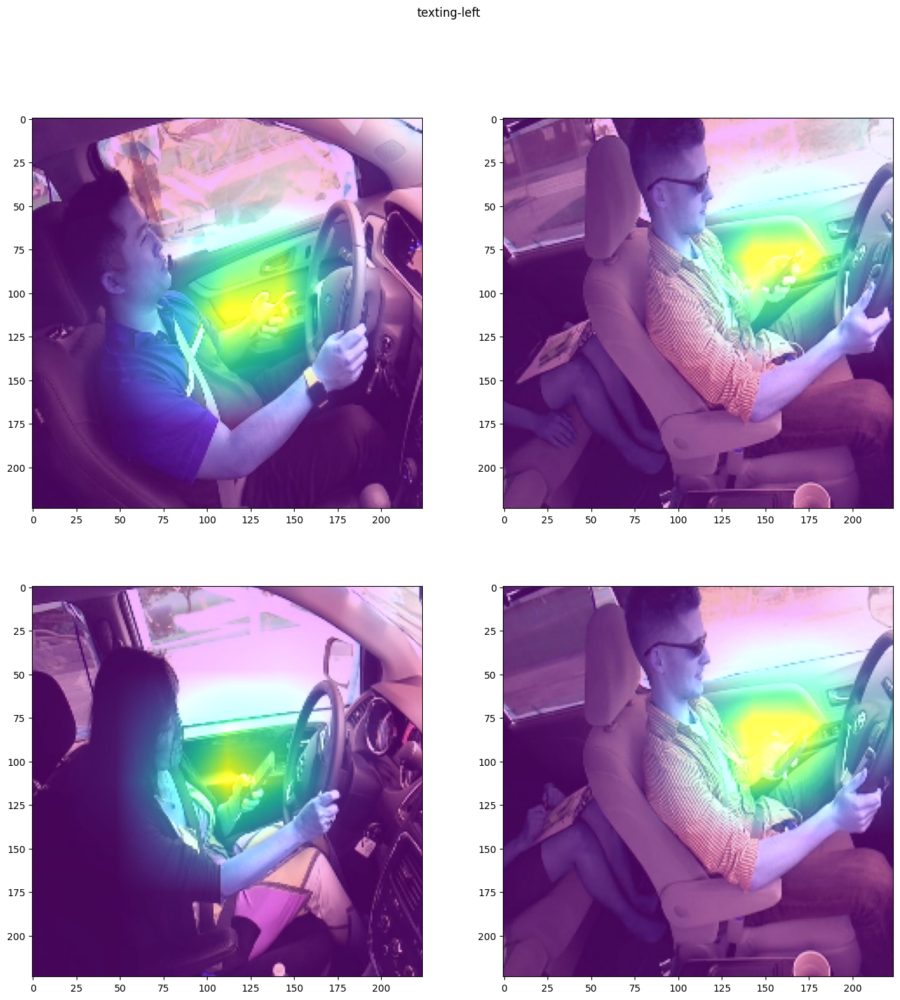

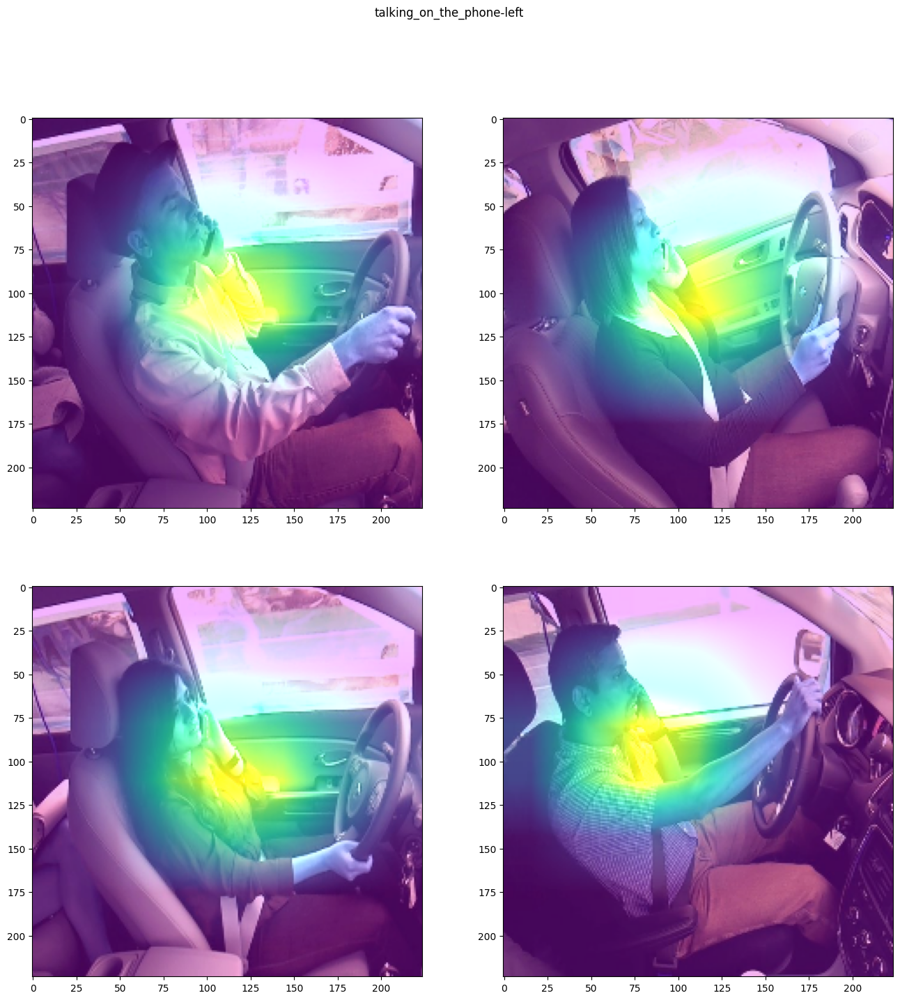

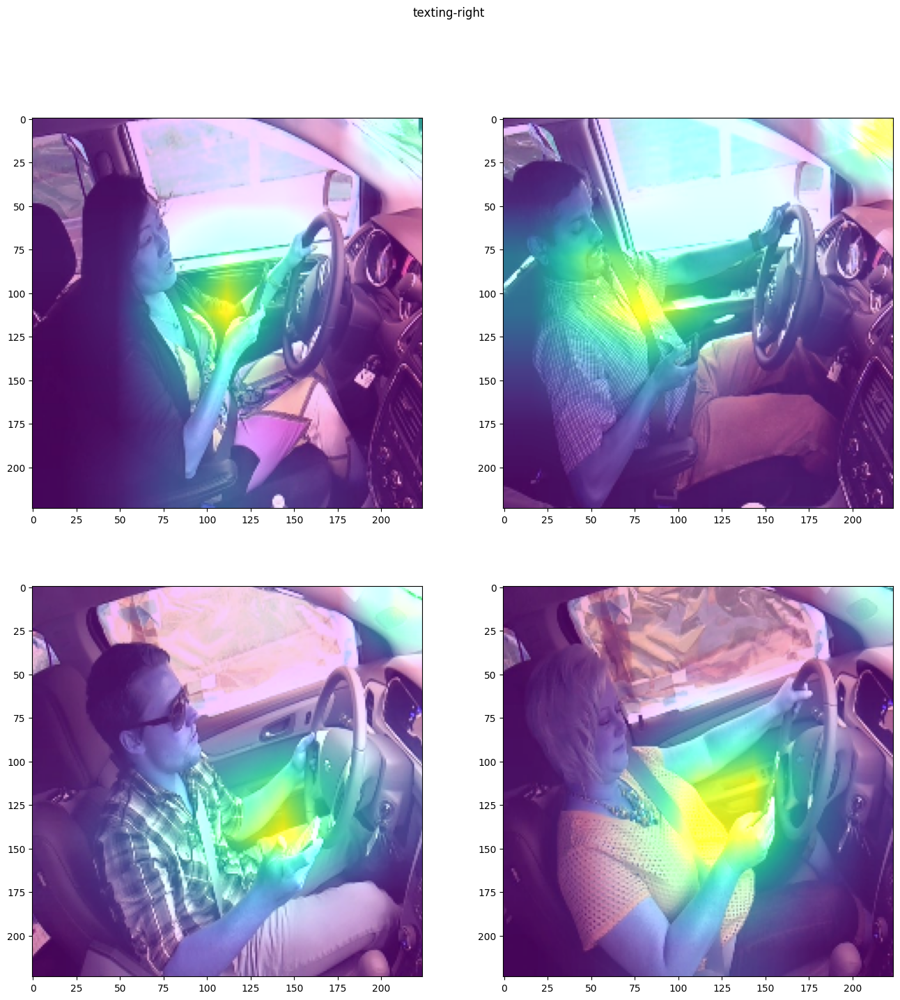

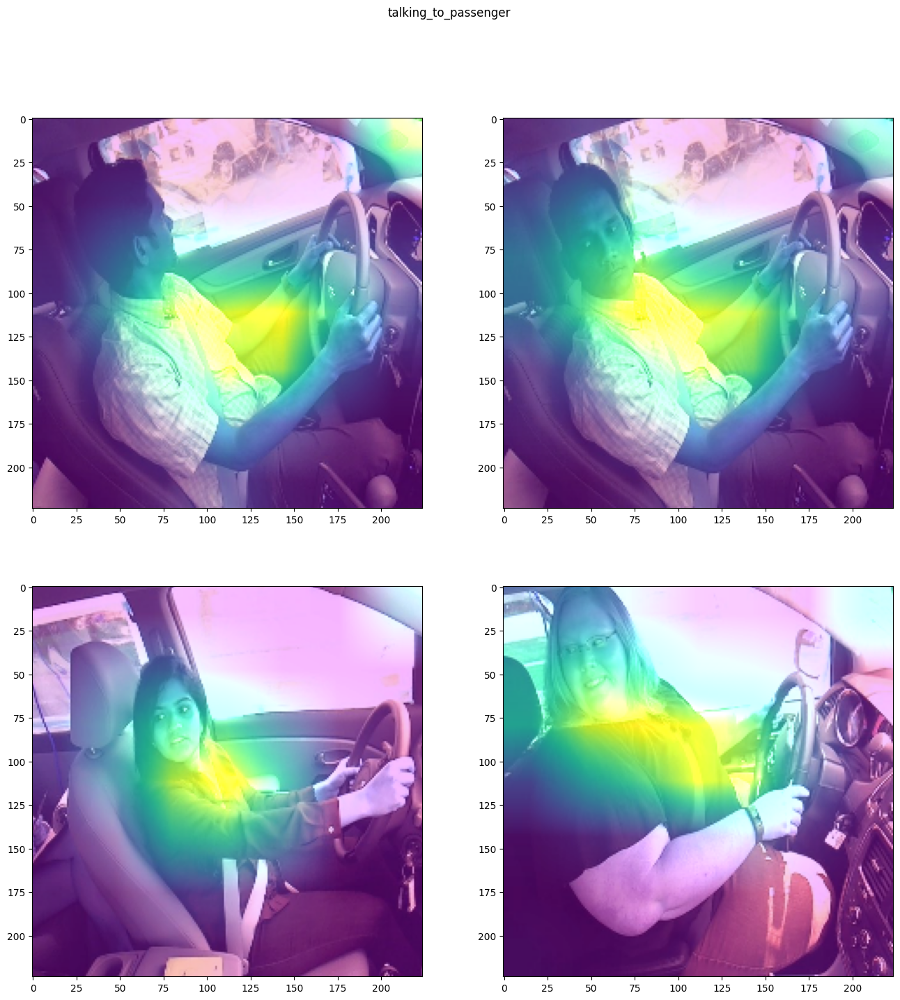

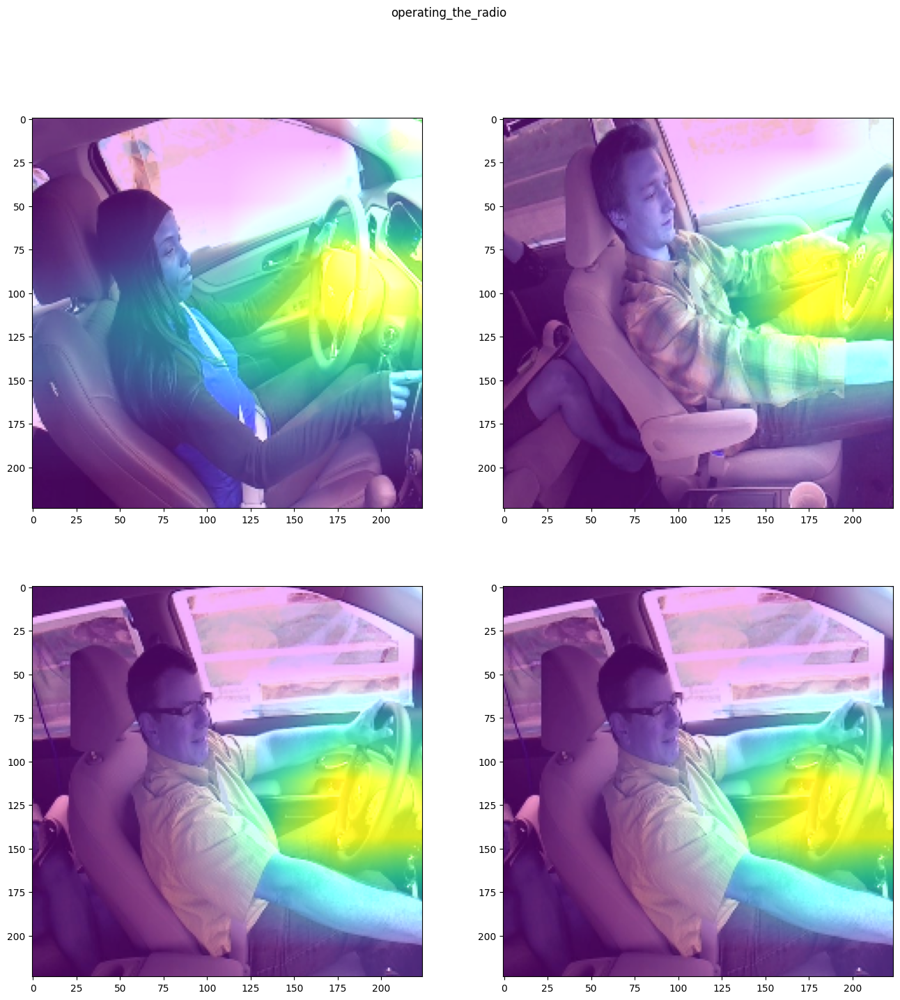

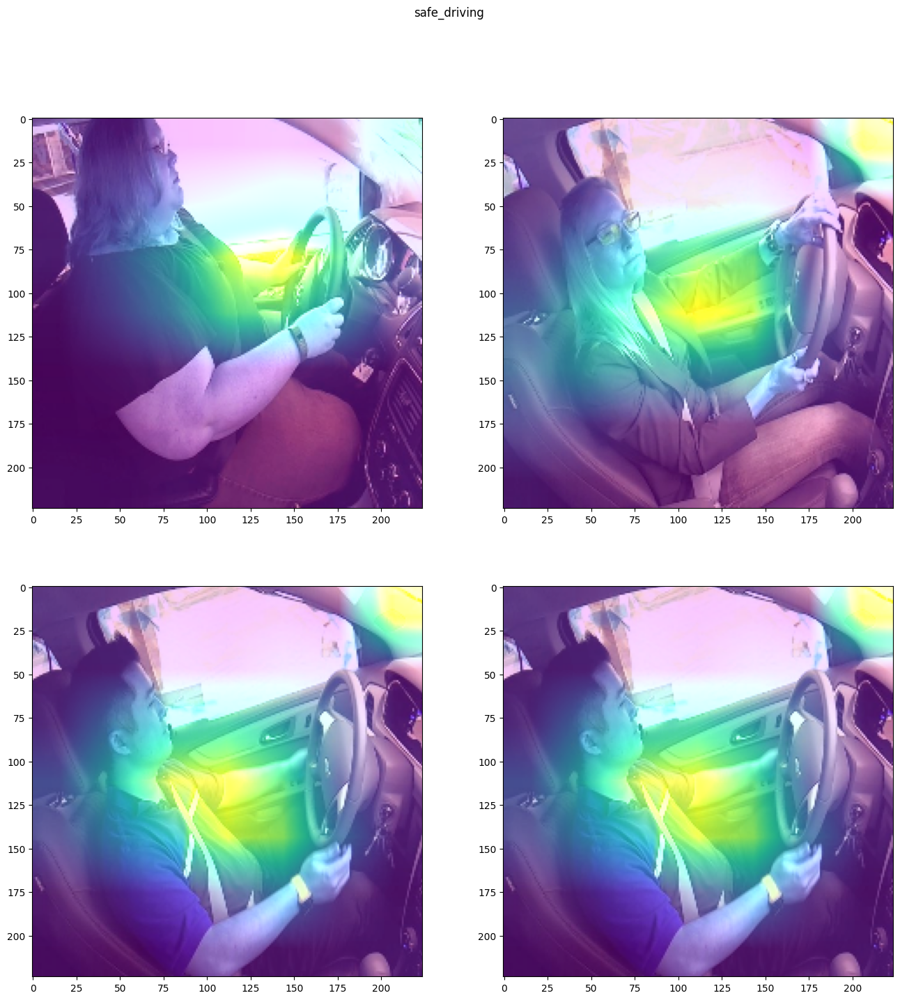

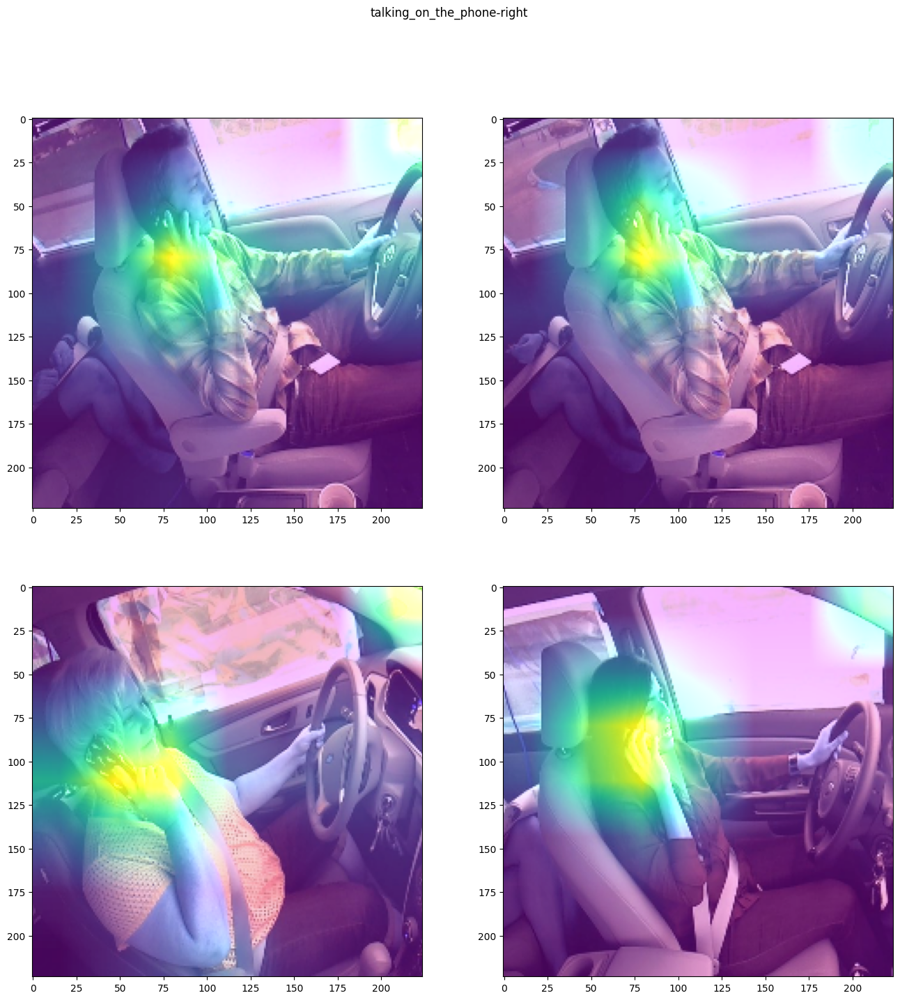

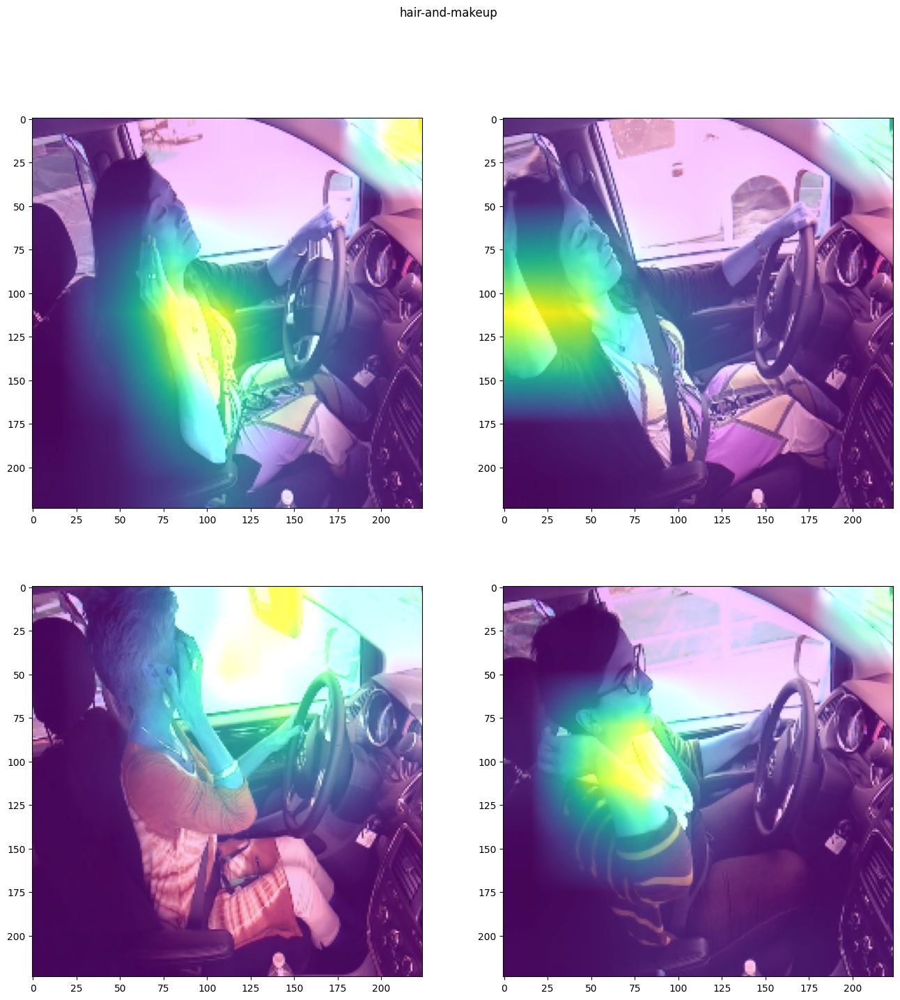

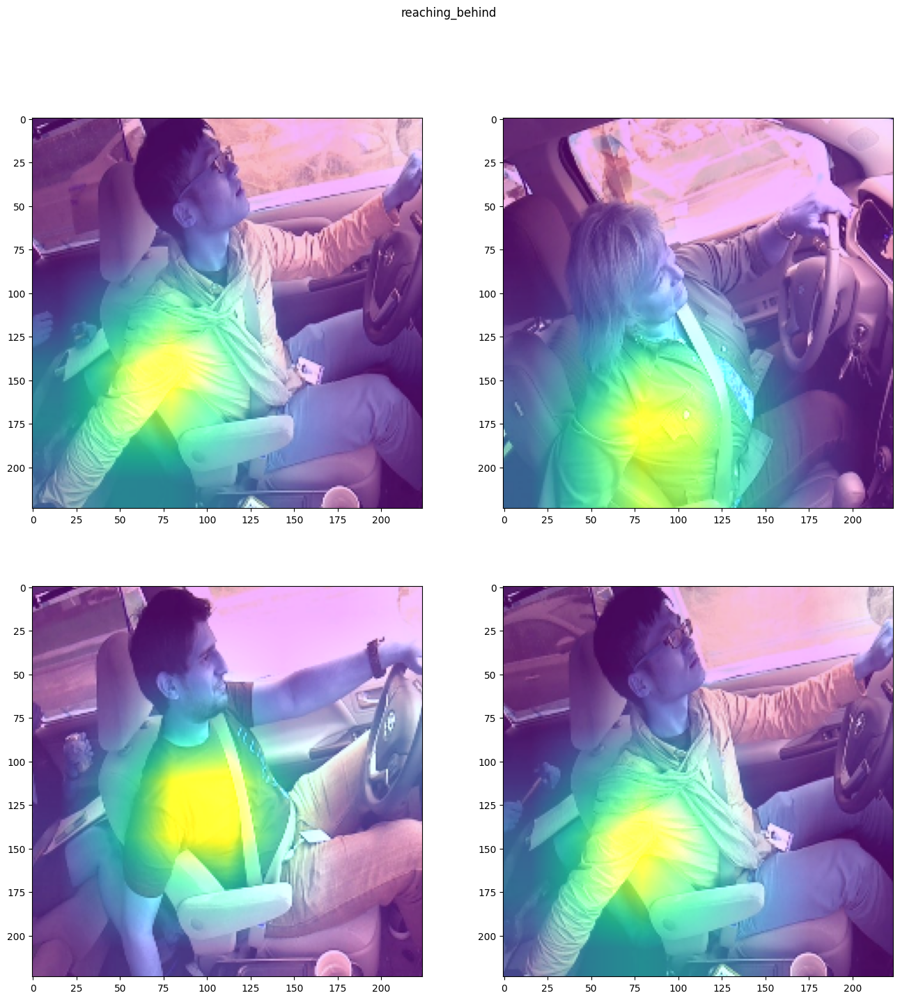

In [ ]:
for class_name in X_test['classname'].unique():
    grad_cam(model, X_test, class_name, dict_class[class_name], (224,224))